In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
cd /content/drive/MyDrive/Precog_Task/

/content/drive/MyDrive/Precog_Task


In [3]:
!pip install wordcloud gensim


In [4]:
import string
import numpy as np
import pandas as pd
import collections
import nltk
from collections import defaultdict
from tqdm.notebook import tqdm
from sklearn.decomposition import TruncatedSVD
from sklearn.decomposition import PCA, NMF
from sklearn.manifold import TSNE
from wordcloud import WordCloud
import tensorflow as tf
import numpy as np

In [5]:
nltk.download("punkt")
nltk.download('punkt_tab')
nltk.download("stopwords")

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [6]:
stopwords = set(nltk.corpus.stopwords.words("english"))
punct = set(string.punctuation)


In [7]:
def preprocess_text(text):
    tokens = text.lower().split()
    tokens = [t for t in tokens if t not in stopwords and t not in punct]
    return tokens


In [8]:
word_counter = collections.Counter()
sentences = []
with open("dataset/high-quality-english-sentences/eng_sentences_300k.txt", 'r', encoding='utf-8') as f:
    for line in f:
        tokens = preprocess_text(line.strip())
        if tokens:
            sentences.append(tokens)

            word_counter.update(tokens)

In [9]:
freq_rank = 50
most_common = word_counter.most_common()

first_singleton_idx = None
for i, (word, count) in enumerate(most_common):
    if count == freq_rank:
        first_singleton_idx = i
        break

print(f"First {freq_rank} freq at rank:", first_singleton_idx + 1)

First 50 freq at rank: 10239


In [10]:
most_common = word_counter.most_common(first_singleton_idx)
vocab_words = [w for w, _ in most_common]

word2id = {w: i for i, w in enumerate(vocab_words)}
id2word = {i: w for w, i in word2id.items()}

In [11]:
print(f"Length of vocab: {len(word2id)}")

Length of vocab: 10238


In [12]:
import numpy as np

def get_cooccurance_matrix(sentences, word2id, window_size=3):
    """
    Build co-occurrence matrix for top-N vocab words only.

    Args:
        sentences (list of list of str): tokenized sentences
        word2id (dict): mapping word -> id (restricted vocab, e.g. top 30k)
        window_size (int): context window size

    Returns:
        np.array: dense co-occurrence matrix (vocab_size x vocab_size)
    """
    vocab_size = len(word2id)
    cooc_matrix = np.zeros((vocab_size, vocab_size), dtype=np.int32)

    for sentence in sentences:
        # keep only vocab words
        sentence_ids = [word2id[w] for w in sentence if w in word2id]

        for idx, curr_word_idx in enumerate(sentence_ids):
            start_idx = max(0, idx - window_size)
            end_idx = min(len(sentence_ids), idx + window_size + 1)

            for j in range(start_idx, end_idx):
                if j != idx:
                    window_word_idx = sentence_ids[j]
                    cooc_matrix[curr_word_idx, window_word_idx] += 1

    return cooc_matrix


In [13]:
def get_top_k_occurances_for_word(word, cooc_matrix, word2idx, k=5):
    if word not in word2idx.keys():
        raise Exception("Word not present in word2idx")

    word_idx = word2idx[word]
    word_row = cooc_matrix[word_idx]

    top_idx_desc = np.argsort(word_row)[::-1]
    top_words = []
    for idx in top_idx_desc:
        if idx == word_idx:
            continue
        if word_row[idx] >0:
            top_words.append((id2word[idx], word_row[idx]))

        if len(top_words) >= k:
            break

    return top_words


In [14]:
def get_df_from_cooccurance_matrix(cooc_matrix, id2word):
    df = pd.DataFrame(cooc_matrix, index=[id2word[idx] for idx in range(len(id2word))], columns=[id2word[idx] for idx in range(len(id2word))])
    return df

In [15]:
cooc_matrix = get_cooccurance_matrix(sentences=sentences, word2id=word2id, window_size=10)

In [16]:
cooc_df = get_df_from_cooccurance_matrix(cooc_matrix, id2word)

In [17]:
cooc_df

,one,also,new,many,may,people,would,use,used,first,...,"rome,",spiral,"assets,",individualized,intervention.,literal,pound,lush,wilson,"asthma,"
one,1580,401,403,520,540,518,529,296,310,523,...,1,4,1,1,1,4,17,1,1,1
also,401,184,370,419,716,341,370,349,474,212,...,2,1,2,0,1,2,1,4,0,2
new,403,370,1234,324,281,277,356,244,177,309,...,3,1,2,3,1,0,2,0,3,1
many,520,419,324,434,319,839,287,265,282,161,...,1,0,1,0,3,0,1,3,1,1
may,540,716,281,319,1066,357,138,320,317,179,...,1,1,2,2,1,1,0,1,1,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
literal,4,2,0,0,1,2,1,3,2,1,...,0,0,0,0,0,0,0,0,0,0
pound,17,1,2,1,0,0,2,2,3,2,...,0,0,0,0,0,0,2,0,0,0
lush,1,4,0,3,1,2,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
wilson,1,0,3,1,1,0,1,1,0,3,...,0,0,0,0,0,0,0,0,0,0


In [17]:
print(get_top_k_occurances_for_word("world", cooc_matrix, word2id, k=10))

[('war', np.int32(574)), ('around', np.int32(309)), ('one', np.int32(273)), ('people', np.int32(218)), ('new', np.int32(194)), ('first', np.int32(186)), ('many', np.int32(168)), ('health', np.int32(160)), ('ii', np.int32(130)), ('also', np.int32(124))]


In [18]:
def get_ppmi_matrix(cooc_matrix):
    total_cnt = np.sum(cooc_matrix)
    row_sum = np.sum(cooc_matrix, axis=1, keepdims=True)
    col_sum = np.sum(cooc_matrix, axis=0, keepdims=True)

    expected = (row_sum @ col_sum) / total_cnt
    pmi = np.log((cooc_matrix * total_cnt) / (expected + 1e-8) + 1e-8)
    ppmi = np.maximum(pmi, 0)

    return ppmi

In [19]:
ppmi_matrix = get_ppmi_matrix(cooc_matrix=cooc_matrix)

In [20]:
ppmi_matrix

array([[18.1100862 , 16.90775879, 16.95605415, ..., 16.35292347,
        16.29587752, 16.2788155 ],
       [16.90775879, 16.29762441, 17.03951188, ..., 17.90810912,
         0.        , 17.14085397],
       [16.95605415, 17.03951188, 18.28734531, ...,  0.        ,
        17.60670132, 16.49102701],
       ...,
       [16.35292347, 17.90810912,  0.        , ...,  0.        ,
         0.        ,  0.        ],
       [16.29587752,  0.        , 17.60670132, ...,  0.        ,
         0.        ,  0.        ],
       [16.2788155 , 17.14085397, 16.49102701, ...,  0.        ,
         0.        ,  0.        ]])

In [21]:
import numpy as np

def top_k_similar(word, ppmi_matrix, word2id, id2word, k=10):
    """
    Find top-k most similar words to a given word using cosine similarity on PPMI rows.

    Args:
        word (str): query word
        ppmi_matrix (np.array or pd.DataFrame): PPMI matrix
        word2id (dict): word -> index mapping
        id2word (dict): index -> word mapping
        k (int): number of neighbors to return

    Returns:
        list of (word, similarity)
    """
    if word not in word2id:
        raise ValueError(f"Word '{word}' not in vocabulary")


    if hasattr(ppmi_matrix, "values"):
        ppmi = ppmi_matrix.values
    else:
        ppmi = ppmi_matrix

    idx = word2id[word]
    vec = ppmi[idx]

    # Cosine similarity
    dot = ppmi @ vec
    norm = np.linalg.norm(ppmi, axis=1) * np.linalg.norm(vec)
    sims = dot / (norm + 1e-8)

    # Get top-k
    top_idx = np.argsort(-sims)
    neighbors = [(id2word[i], sims[i]) for i in top_idx if i != idx][:k]
    return neighbors


In [22]:
print(top_k_similar("man", ppmi_matrix, word2id, id2word, k=10))

[('people', np.float64(0.5700166781678724)), ('us', np.float64(0.5681249691884804)), ('one', np.float64(0.567502857465685)), ('world', np.float64(0.5671016426045523)), ('many', np.float64(0.5662564507163007)), ('first', np.float64(0.5653951368964438)), ('even', np.float64(0.5641904026335968)), ('would', np.float64(0.563993404929071)), ('life', np.float64(0.5631943249850389)), ('time', np.float64(0.5619644262972995))]


In [23]:
import numpy as np

def top_k_neighbors_compare(word, cooc_matrix, ppmi_matrix, word2id, id2word, k=10):
    """
    Compare nearest neighbors of a word from raw co-occurrence and PPMI.

    Args:
        word (str): query word
        cooc_matrix (np.array or pd.DataFrame): raw co-occurrence
        ppmi_matrix (np.array or pd.DataFrame): PPMI matrix
        word2id (dict): word -> index
        id2word (dict): index -> word
        k (int): number of neighbors

    Returns:
        dict: {"cooc": [...], "ppmi": [...]}
    """
    if word not in word2id:
        raise ValueError(f"Word '{word}' not in vocab")

    def get_neighbors(matrix):
        if hasattr(matrix, "values"):
            M = matrix.values
        else:
            M = matrix
        idx = word2id[word]
        vec = M[idx]
        dot = M @ vec
        norm = np.linalg.norm(M, axis=1) * np.linalg.norm(vec)
        sims = dot / (norm + 1e-8)
        top_idx = np.argsort(-sims)
        return [(id2word[i], sims[i]) for i in top_idx if i != idx][:k]

    return {"cooc": get_neighbors(cooc_matrix), "ppmi": get_neighbors(ppmi_matrix)}

In [24]:
results = top_k_neighbors_compare("man", cooc_matrix, ppmi_matrix, word2id, id2word, k=10)

print("Raw Co-occurrence neighbors:")
for w, s in results["cooc"]:
    print(f"{w:15s} {s:.3f}")

print("\nPPMI neighbors:")
for w, s in results["ppmi"]:
    print(f"{w:15s} {s:.3f}")

Raw Co-occurrence neighbors:
woman           0.748
man,            0.700
god             0.690
one             0.682
him,            0.675
made            0.669
true            0.662
ever            0.654
god,            0.654
never           0.652

PPMI neighbors:
people          0.570
us              0.568
one             0.568
world           0.567
many            0.566
first           0.565
even            0.564
would           0.564
life            0.563
time            0.562


In [25]:
def compute_sppmi_matrix(cooc_matrix, k=5):
    total_count = np.sum(cooc_matrix)
    word_freq = np.sum(cooc_matrix, axis=1)
    context_freq = np.sum(cooc_matrix, axis=0)

    sppmi = np.zeros_like(cooc_matrix)

    for i in range(cooc_matrix.shape[0]):
        for j in range(cooc_matrix.shape[1]):
            if cooc_matrix[i, j] == 0:
                continue
            p_wc = cooc_matrix[i, j] / total_count
            p_w = word_freq[i] / total_count
            p_c = context_freq[j] / total_count
            pmi = np.log2(p_wc / (p_w * p_c))
            sppmi[i, j] = max(0, pmi - np.log2(k))
    return sppmi


In [26]:
sppmi_matrix = compute_sppmi_matrix(cooc_matrix, k=5)

In [27]:
print(top_k_similar("man", ppmi_matrix, word2id, id2word, k=10))

[('people', np.float64(0.5700166781678724)), ('us', np.float64(0.5681249691884804)), ('one', np.float64(0.567502857465685)), ('world', np.float64(0.5671016426045523)), ('many', np.float64(0.5662564507163007)), ('first', np.float64(0.5653951368964438)), ('even', np.float64(0.5641904026335968)), ('would', np.float64(0.563993404929071)), ('life', np.float64(0.5631943249850389)), ('time', np.float64(0.5619644262972995))]


# Now to do dimentional reduction ...


In [28]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import TruncatedSVD

def compute_cumulative_variance_svd(sppmi_matrix, max_dim=300):
    """
    Compute cumulative explained variance for SVD up to max_dim dimensions.

    Args:
        sppmi_matrix (np.array): SPPMI matrix of shape (vocab_size, vocab_size)
        max_dim (int): Maximum number of dimensions to consider

    Returns:
        cumulative_variance (np.array): cumulative variance explained for each dimension
    """
    svd = TruncatedSVD(n_components=max_dim, n_iter=10, random_state=42)
    embeddings = svd.fit_transform(sppmi_matrix)
    explained_variance = svd.explained_variance_ratio_
    cumulative_variance = explained_variance.sum()
    return embeddings, cumulative_variance

def plot_cumulative_variance(cumulative_variance):
    """
    Plot cumulative explained variance.

    Args:
        cumulative_variance (np.array): cumulative variance array from compute_cumulative_variance
    """
    plt.figure(figsize=(8,5))
    plt.plot(range(1, len(cumulative_variance)+1), cumulative_variance, marker='o')
    plt.xlabel('Number of Dimensions (d)')
    plt.ylabel('Cumulative Explained Variance')
    plt.title('Choosing SVD Dimension for SPPMI Matrix')
    plt.grid(True)
    plt.show()


In [29]:
embeddings, var_explained = compute_cumulative_variance_svd(cooc_matrix, max_dim=200)

In [30]:
print(var_explained)

0.8914616626157293


In [ ]:
variances = []
for value in tqdm(range(100, 600, 100)):
  print(f"Getting emobeddings for d={value}")
  embeddings, var_explained = compute_cumulative_variance_svd(cooc_matrix, max_dim=value)
  variances.append(var_explained)

  0%|          | 0/5 [00:00<?, ?it/s]

Getting emobeddings for d=100
Getting emobeddings for d=200
Getting emobeddings for d=300
Getting emobeddings for d=400
Getting emobeddings for d=500


In [ ]:
variances

[np.float64(0.8486570416482),
 np.float64(0.8914616626157293),
 np.float64(0.9132879546323787),
 np.float64(0.9275203464826357),
 np.float64(0.9377645839303055)]

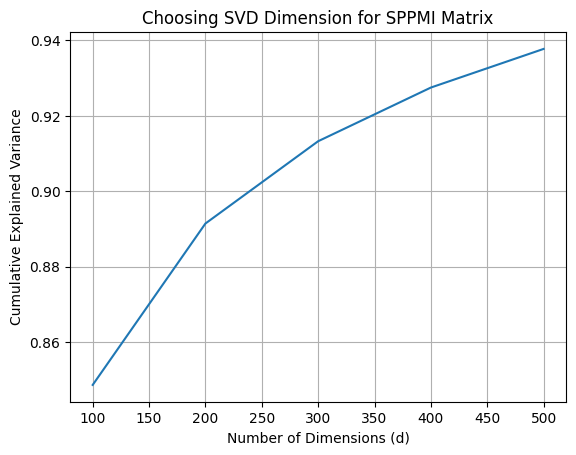

In [ ]:
plt.plot(range(100, 600, 100), variances)
plt.xlabel('Number of Dimensions (d)')
plt.ylabel('Cumulative Explained Variance')
plt.title('Choosing SVD Dimension for COOC Matrix')
plt.grid(True)
plt.show()

In [ ]:
def compute_pca_embeddings(matrix, d):
    """
    Compute PCA embeddings for a given SPPMI matrix and dimension d.

    Args:
        matrix (np.array): SPPMI matrix (vocab_size x vocab_size)
        d (int): number of principal components for embeddings

    Returns:
        embeddings (np.array): dense embeddings of shape (vocab_size, d)
        cumulative_variance (np.array): cumulative explained variance for all components up to d
    """
    pca = PCA(n_components=d, random_state=42)
    embeddings = pca.fit_transform(matrix)

    # cumulative variance explained
    cumulative_variance = pca.explained_variance_ratio_.sum()

    return embeddings, cumulative_variance

In [ ]:
embeddings, var_explained = compute_pca_embeddings(cooc_matrix, d=200)

In [ ]:
print(var_explained)

0.8913710664839762


In [ ]:
variances = []
for value in tqdm(range(100, 600, 100)):
  print(f"Getting emobeddings for d={value}")
  embeddings, var_explained = compute_pca_embeddings(cooc_matrix,  d=value)
  variances.append(var_explained)

  0%|          | 0/5 [00:00<?, ?it/s]

Getting emobeddings for d=100
Getting emobeddings for d=200
Getting emobeddings for d=300
Getting emobeddings for d=400
Getting emobeddings for d=500


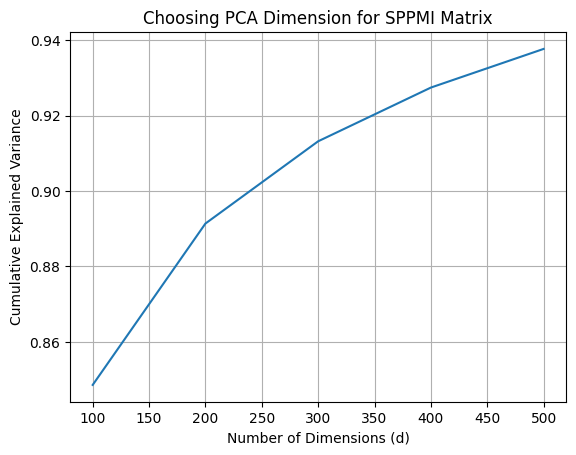

In [ ]:
plt.plot(range(100, 600, 100), variances)
plt.xlabel('Number of Dimensions (d)')
plt.ylabel('Cumulative Explained Variance')
plt.title('Choosing PCA Dimension for COOC Matrix')
plt.grid(True)
plt.show()

In [ ]:
def compute_nmf_embeddings(sppmi_matrix, d, init='random', random_state=42, max_iter=20):
    """
    Compute NMF embeddings for a given SPPMI matrix and dimension d.

    Args:
        sppmi_matrix (np.array): Non-negative SPPMI matrix (vocab_size x vocab_size)
        d (int): number of latent dimensions
        init (str): initialization method ('random' or 'nndsvd')
        random_state (int): random seed
        max_iter (int): maximum number of iterations for convergence

    Returns:
        embeddings (np.array): dense embeddings of shape (vocab_size, d)
        reconstruction_error (float): final Frobenius norm reconstruction error
    """
    nmf_model = NMF(n_components=d, init=init, random_state=random_state, max_iter=max_iter)
    W = nmf_model.fit_transform(sppmi_matrix)
    H = nmf_model.components_

    reconstruction_error = nmf_model.reconstruction_err_
    return W, reconstruction_error

In [ ]:
embeddings, error = compute_nmf_embeddings(cooc_matrix, d=200)

/usr/local/lib/python3.12/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 20 reached. Increase it to improve convergence.
  warnings.warn(


In [ ]:
print(error)

6753.592302556436


In [ ]:
errors = []
for value in tqdm(range(100, 600, 100)):
  print(f"Getting emobeddings for d={value}")
  embeddings, errors_explained = compute_nmf_embeddings(cooc_matrix,  d=value)
  errors.append(errors_explained)

  0%|          | 0/5 [00:00<?, ?it/s]

Getting emobeddings for d=100
Getting emobeddings for d=200
Getting emobeddings for d=300
Getting emobeddings for d=400
Getting emobeddings for d=500


In [ ]:
plt.plot(range(100, 600, 100), errors)
plt.xlabel('Number of Dimensions (d)')
plt.ylabel('Errors')
plt.title('Choosing NMF Dimension for COOC Matrix')
plt.grid(True)
plt.show()

# Visualizing these embeddings


In [31]:
svd_embs, var = compute_cumulative_variance_svd(cooc_matrix, max_dim=300)

In [44]:
import numpy as np
from scipy.stats import spearmanr

def cosine_similarity(vec1, vec2):
    return np.dot(vec1, vec2) / (np.linalg.norm(vec1) * np.linalg.norm(vec2))

def safe_lower(word):
    """Convert word to lowercase if it's a string, else return as-is."""
    return word.lower() if isinstance(word, str) else word

def evaluate_similarity(embeddings, word2id, word_pairs, human_scores, lowercase=True):
    pred_scores = []
    gold_scores = []

    for (w1, w2), score in zip(word_pairs, human_scores):
        if lowercase:
            w1, w2 = safe_lower(w1), safe_lower(w2)

        if w1 in word2id and w2 in word2id:
            vec1 = embeddings[word2id[w1]]
            vec2 = embeddings[word2id[w2]]
            pred_scores.append(cosine_similarity(vec1, vec2))
            gold_scores.append(score)

    if len(pred_scores) == 0:
        print("No valid word pairs found in vocab!")
        return np.nan

    correlation, _ = spearmanr(pred_scores, gold_scores)
    return correlation

In [45]:
import pandas as pd

# Load WordSim-353 dataset
ws353 = pd.read_csv("dataset/wordsim353crowd.csv", delimiter="\t", header=None, names=["Word1", "Word2", "Human_Score"])

# Prepare word pairs and human scores
word_pairs_ws353 = list(zip(ws353["Word1"], ws353["Word2"]))
human_scores_ws353 = ws353["Human_Score"].tolist()

In [46]:
# Load MEN dataset
men = pd.read_csv("dataset/MEN_dataset_natural_form_full", delimiter="\t", header=None, names=["Word1", "Word2", "Human_Score"])

# Prepare word pairs and human scores
word_pairs_men = list(zip(men["Word1"], men["Word2"]))
human_scores_men = men["Human_Score"].tolist()

In [47]:
# Load SimLex-999
simlex = pd.read_csv("dataset/SimLex-999.txt", delimiter="\t")

# Columns of interest: 'word1', 'word2', 'SimLex999' (human similarity score)
word_pairs_simplex = list(zip(simlex['word1'], simlex['word2']))
human_scores_simlex = simlex['SimLex999'].tolist()

In [48]:
spearman_corr_ws = evaluate_similarity(svd_embs, word2id, word_pairs_ws353, human_scores_ws353)
spearman_corr_men = evaluate_similarity(svd_embs, word2id, word_pairs_men, human_scores_men)
spearman_corr_simplex = evaluate_similarity(svd_embs, word2id, word_pairs_simplex, human_scores_simlex)

No valid word pairs found in vocab!
No valid word pairs found in vocab!


In [49]:
print(spearman_corr_ws)
print(spearman_corr_men)
print(spearman_corr_simplex)

nan
nan
0.19092123752434806


In [53]:
words_to_visualize = list(word2id.keys())[:30]

In [57]:
def visualize_embeddings_tsne(embeddings, word2id, words, perplexity=3, learning_rate=200):
    # Filter words present in word2id
    words = [w for w in words if w in word2id]
    indices = [word2id[w] for w in words]
    selected_emb = embeddings[indices]

    tsne = TSNE(n_components=2, perplexity=perplexity, learning_rate=learning_rate, random_state=42)
    emb_2d = tsne.fit_transform(selected_emb)

    plt.figure(figsize=(12, 8))
    plt.scatter(emb_2d[:, 0], emb_2d[:, 1], color='red')

    for i, word in enumerate(words):
        plt.text(emb_2d[i, 0]+0.5, emb_2d[i, 1]+0.5, word, fontsize=10)

    plt.title("t-SNE Visualization of Word Embeddings")
    plt.xlabel("Dimension 1")
    plt.ylabel("Dimension 2")
    plt.grid(True)
    plt.show()

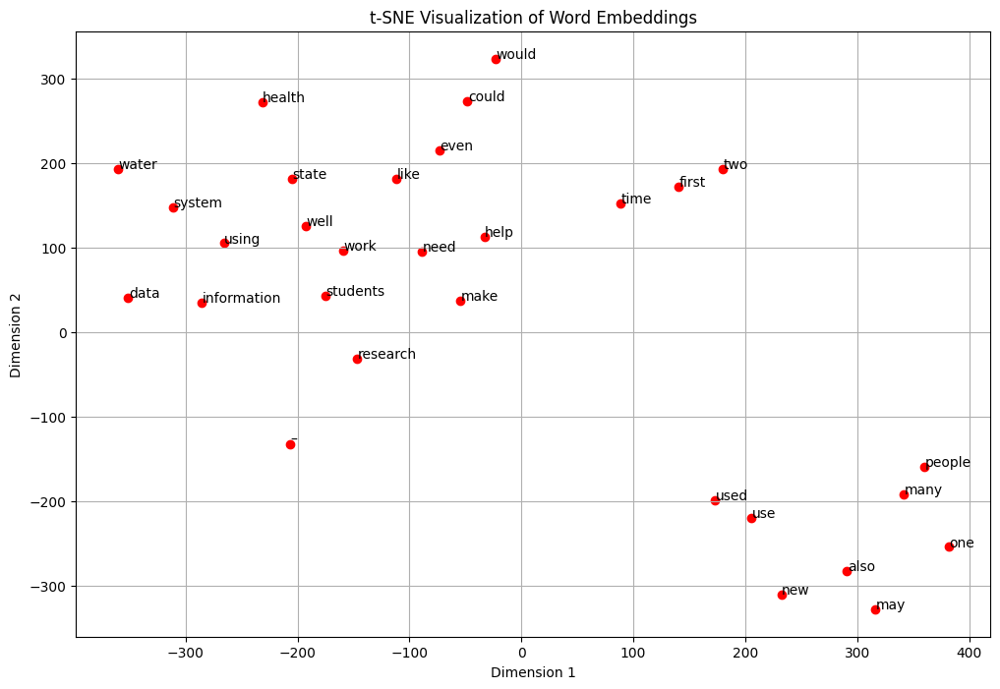

In [58]:
visualize_embeddings_tsne(svd_embs, word2id, words_to_visualize)

In [59]:
words_to_plot = ["doctor", "nurse", "hospital", "patient", "medicine",
                 "computer", "data", "network", "science", "research"]

In [60]:
vectors = []
labels = []
for w in words_to_plot:
    if w in word2id:
        vectors.append(svd_embs[word2id[w]])
        labels.append(w)

vectors = np.array(vectors)

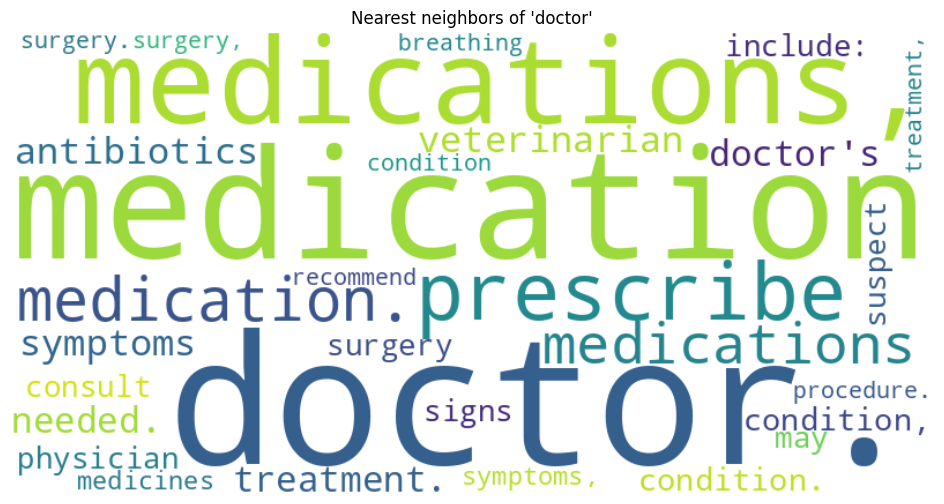

In [63]:
import numpy as np
from wordcloud import WordCloud
import matplotlib.pyplot as plt

def cosine_similarity(vec1, vec2):
    return np.dot(vec1, vec2) / (np.linalg.norm(vec1) * np.linalg.norm(vec2))

def get_word_cloud(target_word, embeddings, word2id, topn=50):
    if target_word not in word2id:
        print(f"Word '{target_word}' not in vocab.")
        return

    target_vec = embeddings[word2id[target_word]]

    # compute similarities with all vocab words
    sims = {}
    for word, idx in word2id.items():
        if word != target_word:
            sims[word] = cosine_similarity(target_vec, embeddings[idx])


    top_words = dict(sorted(sims.items(), key=lambda x: x[1], reverse=True)[:topn])


    wc = WordCloud(width=800, height=400, background_color="white")
    wc.generate_from_frequencies(top_words)


    plt.figure(figsize=(12, 6))
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.title(f"Nearest neighbors of '{target_word}'")
    plt.show()

# Example usage:
get_word_cloud("doctor", svd_embs, word2id, topn=30)

In [64]:
# Save words in Tensorboard visualization:
import numpy as np

def save_embeddings_for_projector(embeddings, word2id, vecs_path="vecs.tsv", meta_path="meta.tsv"):
    with open(vecs_path, "w", encoding="utf-8") as f_vec, open(meta_path, "w", encoding="utf-8") as f_meta:
        for word, idx in word2id.items():
            vec = embeddings[idx]
            f_vec.write("\t".join(map(str, vec)) + "\n")
            f_meta.write(word + "\n")

save_embeddings_for_projector(svd_embs, word2id)

In [67]:
embedding_var = tf.Variable(svd_embs, name="word_embeddings")

In [68]:
from tensorboard.plugins import projector
import os

log_dir = "logs/embeddings"
os.makedirs(log_dir, exist_ok=True)

checkpoint = tf.train.Checkpoint(embedding=embedding_var)
checkpoint.save(os.path.join(log_dir, "embeddings.ckpt"))

'logs/embeddings/embeddings.ckpt-1'

In [69]:
# Set up projector config
config = projector.ProjectorConfig()
embedding = config.embeddings.add()
embedding.tensor_name = "word_embeddings"
embedding.metadata_path = "meta.tsv"

projector.visualize_embeddings(log_dir, config)


In [73]:
%load_ext tensorboard

In [74]:
%tensorboard --logdir=logs/embeddings

Output hidden; open in https://colab.research.google.com to view.

# Work with Word2Vec

In [18]:
import gensim.downloader as api

# Load pre-trained Word2Vec
model = api.load("word2vec-google-news-300")


[==================================================] 100.0% 1662.8/1662.8MB downloaded


In [20]:
model.vector_size

300

In [21]:
def cosine_similarity(vec1, vec2):
    return np.dot(vec1, vec2) / (np.linalg.norm(vec1) * np.linalg.norm(vec2))

In [25]:
from scipy.stats import spearmanr

def safe_lower(word):
    """Convert to lowercase if string, otherwise return None"""
    if isinstance(word, str):
        return word.lower()
    return None
def evaluate_word2vec(model, word_pairs, human_scores, lowercase=True):
    pred_scores = []
    gold_scores = []

    for (w1, w2), score in zip(word_pairs, human_scores):
        if lowercase:
            w1 = safe_lower(w1)
            w2 = safe_lower(w2)

        # Skip if either word is missing or None
        if w1 is None or w2 is None:
            continue

        if w1 in model.key_to_index and w2 in model.key_to_index:
            vec1 = model[w1]
            vec2 = model[w2]
            pred_scores.append(np.dot(vec1, vec2) / (np.linalg.norm(vec1) * np.linalg.norm(vec2)))
            gold_scores.append(score)

    if len(pred_scores) == 0:
        print("No valid word pairs found in vocab!")
        return np.nan

    correlation, _ = spearmanr(pred_scores, gold_scores)
    coverage = len(pred_scores) / len(human_scores) * 100
    print(f"Valid pairs: {len(pred_scores)}/{len(human_scores)} ({coverage:.2f}% coverage)")

    return correlation



In [26]:
import pandas as pd

# WordSim-353
ws353 = pd.read_csv("dataset/wordsim353crowd.csv", delimiter="\t", header=None, names=["Word1", "Word2", "Human_Score"])
word_pairs_ws353 = list(zip(ws353["Word1"], ws353["Word2"]))
human_scores_ws353 = ws353["Human_Score"].tolist()

# MEN
men = pd.read_csv("dataset/MEN_dataset_natural_form_full", delimiter="\t", header=None, names=["Word1", "Word2", "Human_Score"])
word_pairs_men = list(zip(men["Word1"], men["Word2"]))
human_scores_men = men["Human_Score"].tolist()

# SimLex-999
simlex = pd.read_csv("dataset/SimLex-999.txt", delimiter="\t")
word_pairs_simlex = list(zip(simlex['word1'], simlex['word2']))
human_scores_simlex = simlex['SimLex999'].tolist()


In [27]:
spearman_ws = evaluate_word2vec(model, word_pairs_ws353, human_scores_ws353)
spearman_men = evaluate_word2vec(model, word_pairs_men, human_scores_men)
spearman_simlex = evaluate_word2vec(model, word_pairs_simlex, human_scores_simlex)

print("WordSim-353 Spearman:", spearman_ws)
print("MEN Spearman:", spearman_men)
print("SimLex-999 Spearman:", spearman_simlex)


No valid word pairs found in vocab!
No valid word pairs found in vocab!
Valid pairs: 999/999 (100.00% coverage)
WordSim-353 Spearman: nan
MEN Spearman: nan
SimLex-999 Spearman: 0.44196551091403796
